In [1]:
# Standard Library
import argparse
from time import perf_counter

# Third Party Library
import matplotlib.pyplot as plt
%matplotlib inline
import networkx as nx
import optuna
import pandas as pd
from egraph import Drawing, all_sources_bfs
from ex_utils.config.dataset import dataset_names
from ex_utils.config.paths import get_dataset_path
from ex_utils.config.quality_metrics import qm_names, qm_name_abbreviations
from ex_utils.share import (
    draw,
    draw_and_measure,
    ex_path,
    generate_base_df_data,
)
from ex_utils.utils.graph import (
    egraph_graph,
    load_nx_graph,
    nx_graph_preprocessing,
)
from tqdm import tqdm
import plotly.graph_objects as go
from statistics import mean, stdev
from sklearn.preprocessing import StandardScaler

/Users/fuga_takata/dev/vdslab-project/hyperparameter-in-graph-drawing/.venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


/var/folders/23/db_nbhl55hvds1mt0zx_p14h0000gn/T/ipykernel_30736/2041394116.py:72: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
/var/folders/23/db_nbhl55hvds1mt0zx_p14h0000gn/T/ipykernel_30736/2041394116.py:72: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
/var/folders/23/db_nbhl55hvds1mt0zx_p14h0000gn/T/ipykernel_30736/2041394116.py:72: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
/var/folders/23/db_nbhl55hvds1mt0zx_p14h0000gn/T/ipykernel_30736/2041394116.py:72: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
/var/folders/23/db_nbhl55hvds1mt0zx_p14h0000gn/T/ipykernel_30736/2041394116.py:72: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()
/var/folders/23/db_nbhl55hvds1mt0zx_p14h0000gn/T/ipykernel_30736/2041394116.py:72: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be

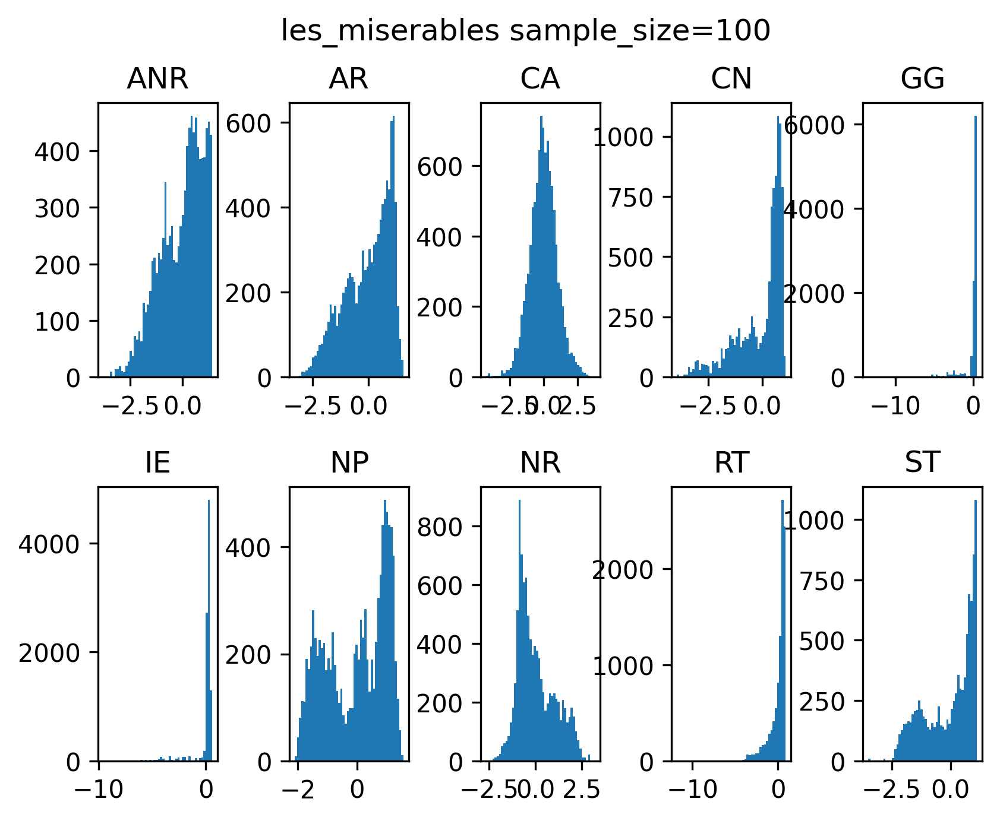

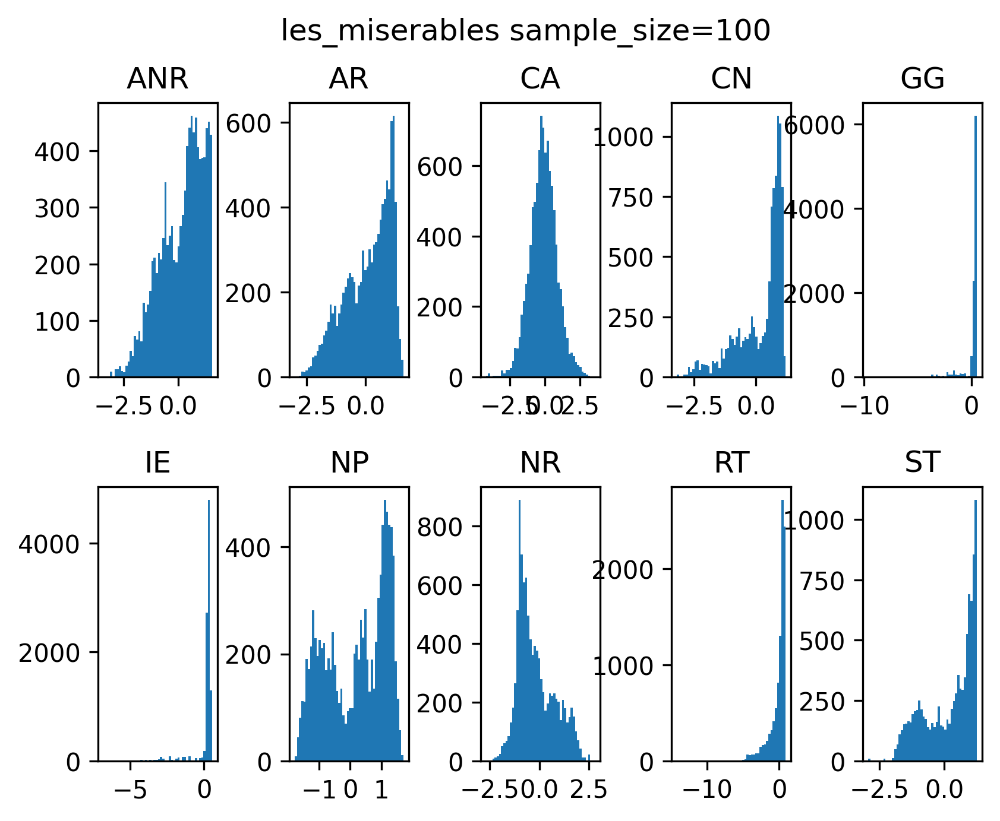

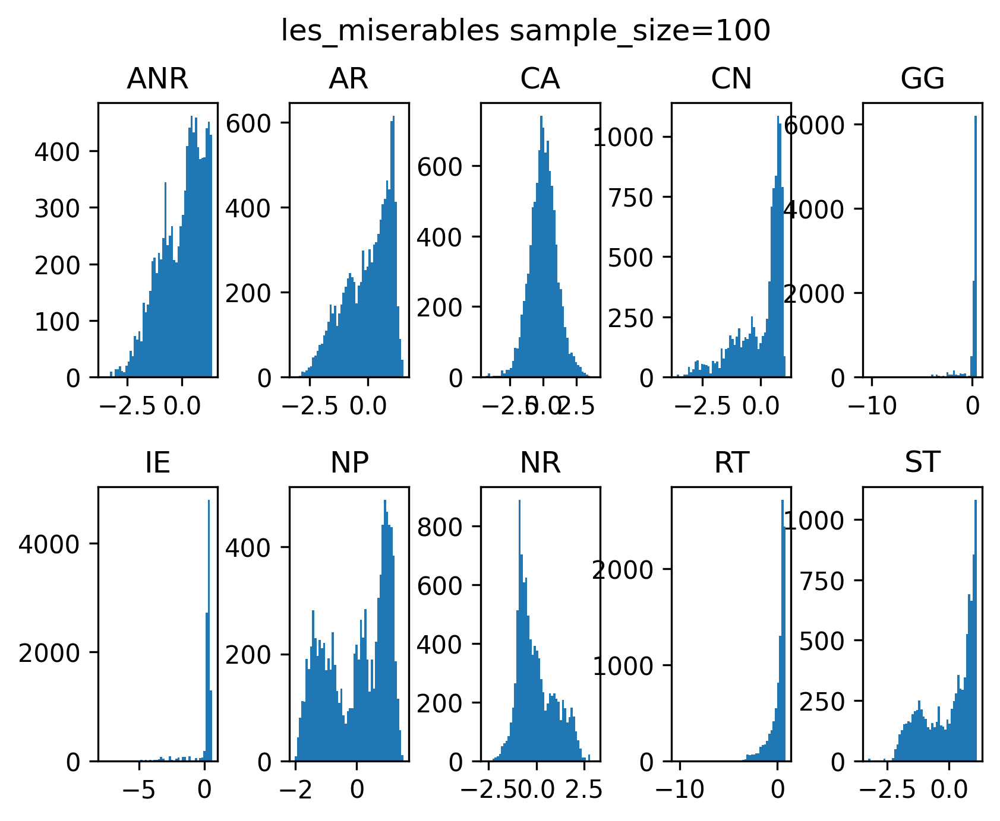

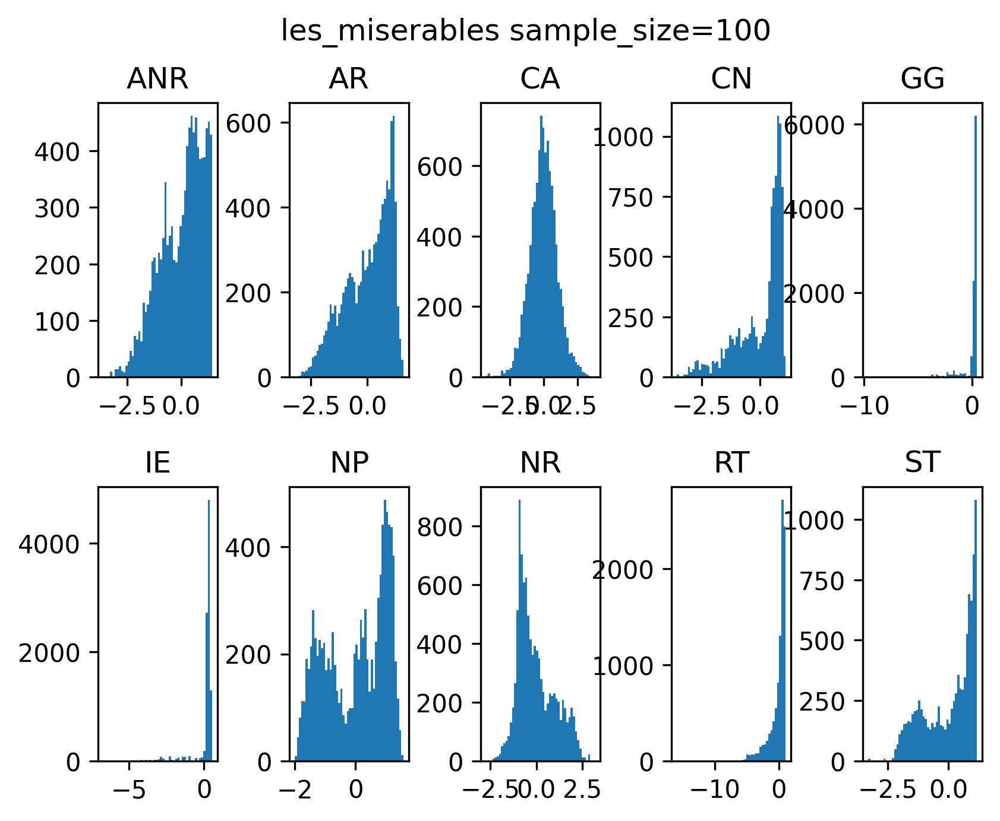

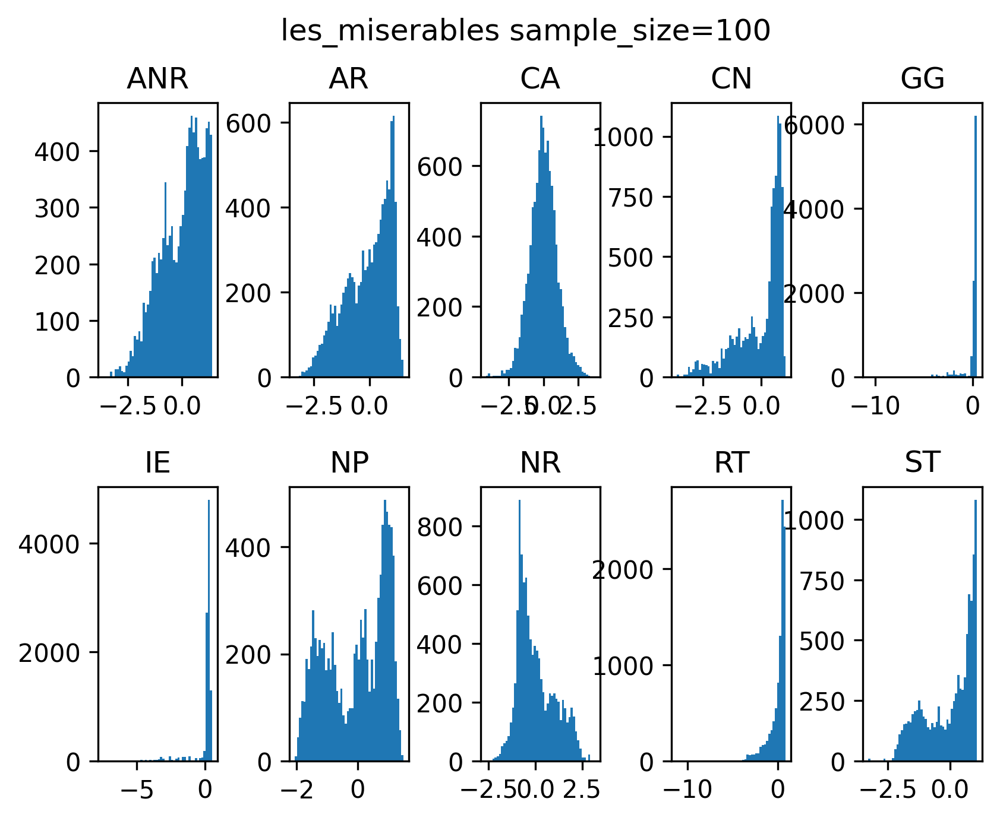

...

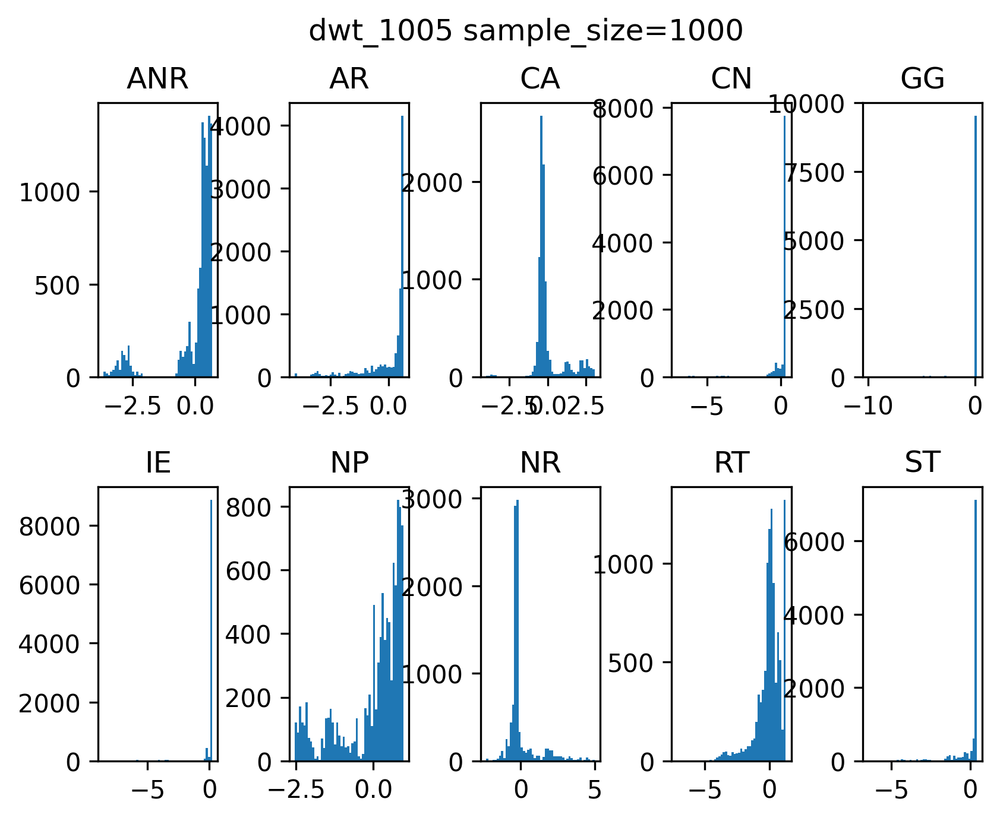

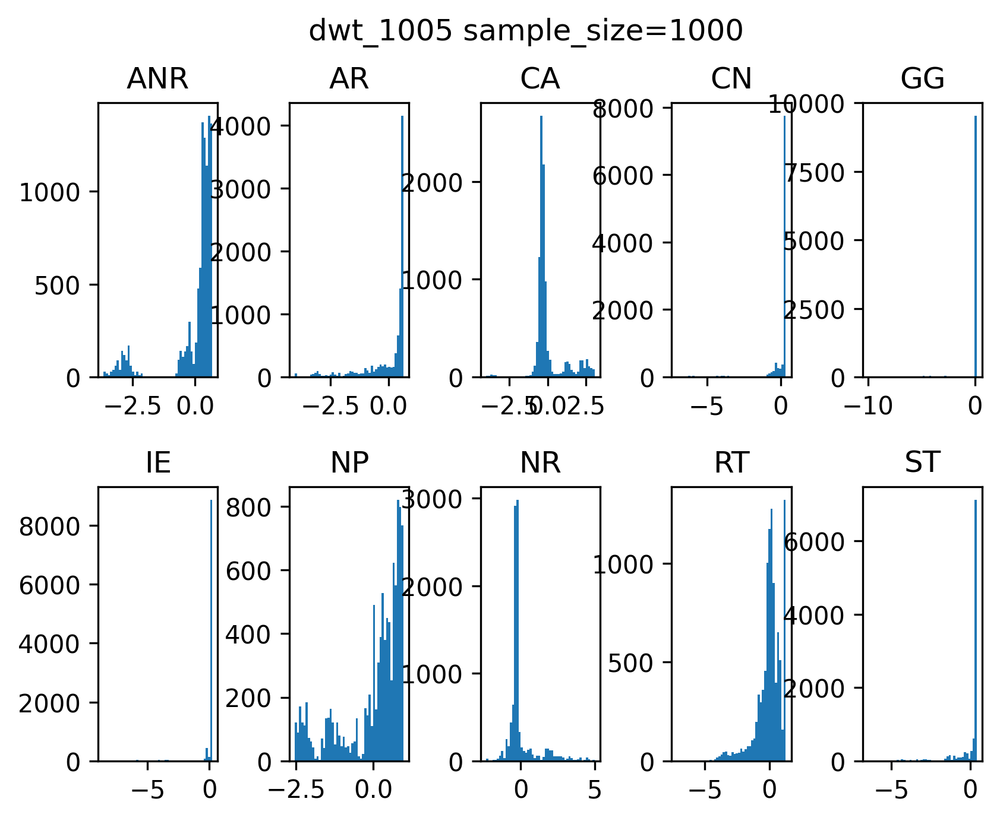

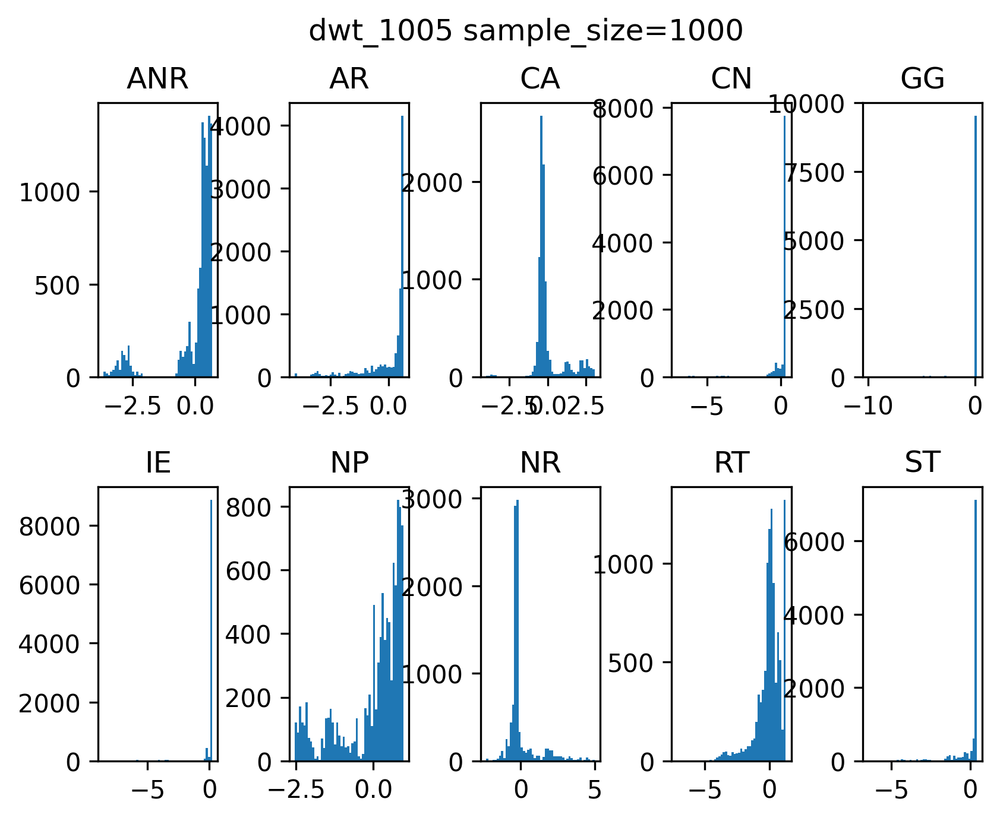

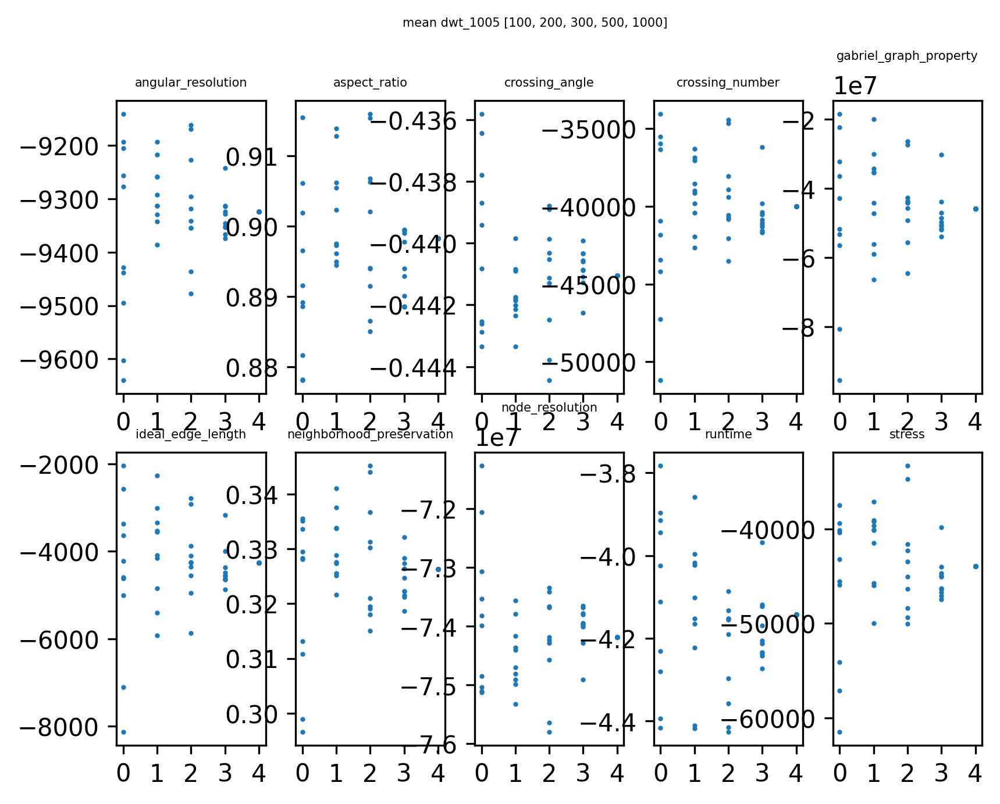

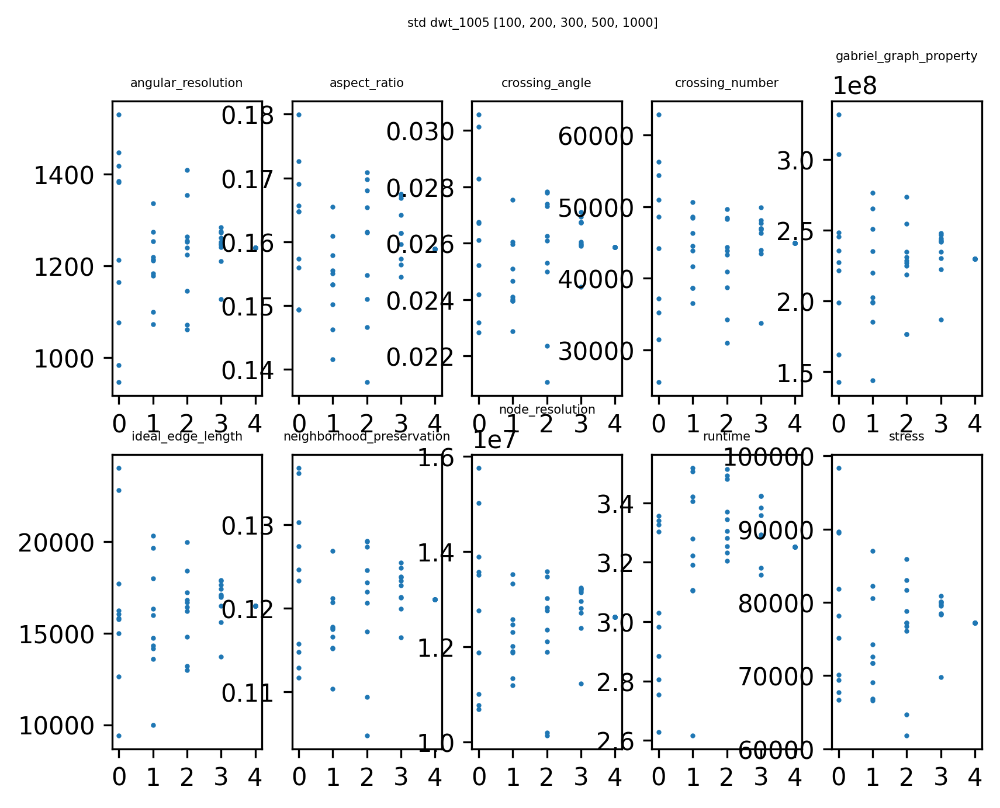

In [2]:
for d_name in ["les_miserables", "1138_bus", "USpowerGrid", "dwt_1005"]:
    sample_n = 10
    n_split = 10
    data_seeds = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
    df_paths = [
        ex_path.joinpath(
            f"data/grid/percentage_pivots/{d_name}/seed={data_seed}_n={n_split}.pkl"
        )
        for data_seed in data_seeds
    ]
    base_df = pd.concat(
        [pd.read_pickle(df_path) for df_path in df_paths]
    ).reset_index()

    df_for_sample = pd.read_pickle(
        ex_path.joinpath(
            f"data/grid/percentage_pivots/{d_name}/seed={0}_n={n_split}.pkl"
        )
    )

    plot_data = []
    # sample_sizes = [1, 10, 100, 200, 300, 400, 500, 1000]
    sample_sizes = [10, 100, 200, 300, 500, 1000]
    for index, sample_size in enumerate(sample_sizes):
        for _ in range(sample_n):
            sampled_df = df_for_sample.sample(n=sample_size)
            sampled_grid_point = [
                (row.params_pivots, row.params_iterations, row.params_eps)
                for row in sampled_df.itertuples()
            ]
            df = pd.concat(
                [
                    base_df.query(
                        f"params_pivots == {p} and params_iterations == {i} and params_eps == {e}"
                    )
                    for p, i, e in sampled_grid_point
                ]
            )

            plot_data_obj = {}
            plot_data_obj["sample_size"] = f"{index}"
            for qm_name in qm_names:
                plot_data_obj[f"mean_{qm_name}"] = df[
                    f"values_{qm_name}"
                ].mean()
                # groupbyしてmedian
                plot_data_obj[f"std_{qm_name}"] = df[f"values_{qm_name}"].std()

            plot_data.append(plot_data_obj)

            nrows = 2
            ncols = 5
            fig, axes = plt.subplots(
                nrows=nrows,
                ncols=ncols,
                dpi=300,
                facecolor="white",
                squeeze=False,
            )
            fig.suptitle(f"{d_name} sample_size={sample_size}")
            plt.subplots_adjust(wspace=0.6, hspace=0.4)

            for qm_name, ax in zip(qm_names, axes.flatten()):
                sscaler = StandardScaler()
                sscaler.fit(df[f"values_{qm_name}"].values.reshape(-1, 1))
                sscaled_values = sscaler.transform(
                    base_df[f"values_{qm_name}"].values.reshape(-1, 1)
                )

                ax.hist(sscaled_values, bins=50)
                ax.set_title(f"{qm_name_abbreviations[qm_name]}")

            fig.show()

    plot_df = pd.DataFrame(plot_data)

    fig, axes = plt.subplots(
        nrows=2, ncols=5, dpi=300, facecolor="white", squeeze=False
    )
    fig.suptitle(f"mean {d_name} {sample_sizes}", fontsize=5)
    for qm_name, ax in zip(qm_names, axes.flatten()):
        ax.set_title(f"{qm_name}", fontsize=5)

        ax.scatter(plot_df["sample_size"], plot_df[f"mean_{qm_name}"], s=1)
    fig.show()

    fig, axes = plt.subplots(
        nrows=2, ncols=5, dpi=300, facecolor="white", squeeze=False
    )
    fig.suptitle(f"std {d_name} {sample_sizes}", fontsize=5)
    for qm_name, ax in zip(qm_names, axes.flatten()):
        ax.set_title(f"{qm_name}", fontsize=5)

        ax.scatter(plot_df["sample_size"], plot_df[f"std_{qm_name}"], s=1)
    fig.show()

In [3]:
# sampled_df = df_for_sample.sample(n=1000)
# sampled_grid_point = [
#     (row.params_pivots, row.params_iterations, row.params_eps)
#     for row in sampled_df.itertuples()
# ]
# df = pd.concat(
#     [
#         base_df.query(
#             f"params_pivots == {p} and params_iterations == {i} and params_eps == {e}"
#         )
#         for p, i, e in sampled_grid_point
#     ]
# )
# df

In [4]:
for i, v in enumerate([2, 3, 4]):
    print(i, v)

0 2
1 3
2 4


In [5]:
df

,index,params_pivots,params_iterations,params_eps,values_angular_resolution,values_aspect_ratio,values_crossing_number,values_gabriel_graph_property,values_ideal_edge_length,values_neighborhood_preservation,values_node_resolution,values_stress,values_crossing_angle,values_runtime,seed,edge_weight
499,499,22,200,1.0,-8929.832031,0.901843,-26838.0,-342506.625000,-533.776062,0.363897,-76073640.0,-14156.569336,-0.454491,-0.164345,0,30
1499,499,22,200,1.0,-8984.075195,0.916904,-26876.0,-340688.312500,-525.514465,0.365364,-80130008.0,-13850.569336,-0.453155,-4.496199,1,30
2499,499,22,200,1.0,-8855.386719,0.990406,-26524.0,-297278.531250,-492.921387,0.374853,-79001576.0,-12706.478516,-0.458210,-4.863032,2,30
3499,499,22,200,1.0,-9030.371094,0.981313,-26698.0,-341156.062500,-523.318176,0.357455,-77037048.0,-12284.266602,-0.465693,-1.766497,3,30
4499,499,22,200,1.0,-8931.120117,0.945458,-26432.0,-323528.093750,-506.449097,0.369169,-83130712.0,-13251.193359,-0.454207,-1.328532,4,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5869,869,467,133,1.0,-8671.483398,0.995502,-25523.0,-239544.046875,-443.301544,0.423684,-77562224.0,-10961.713867,-0.451370,-4.661153,5,30
6869,869,467,133,1.0,-8665.343750,0.997640,-25505.0,-230525.031250,-447.299957,0.427019,-77798432.0,-10967.657227,-0.452066,-6.240671,6,30
7869,869,467,133,1.0,-8652.979492,0.998772,-25194.0,-230933.328125,-446.600983,0.429295,-78157920.0,-10976.512695,-0.453632,-8.014880,7,30
8869,869,467,133,1.0,-8608.792969,0.992739,-25245.0,-216477.453125,-431.093719,0.431310,-77775608.0,-10890.771484,-0.451806,-7.118707,8,30
